In [1]:
import pandas as pd
Results_Unlearn  = './Evaluation_Results_KNN_Vote.csv'
# test = '/home/yupaporn/codes/USAI/Testdf.csv'
Results_Unlearn = pd.read_csv (Results_Unlearn)

Results_Unlearn.head()

,Path Crop,Sub_class_New,Sub_Position_Label,KNN_Vote_Result_15AB_top3,KNN_Vote_Result_15AB_top5,KNN_Vote_Result_Sub_Position_top3,KNN_Vote_Result_Sub_Position_top5,Path Crop_match_train_all,Sub_class_Unlearn_match_train_all,Sub_Position_Unlearn_match_train_all,...,Distance_top3,Unlearn_pred_15AB_top4,Unlearn_pred_Sub_Position_top4,Distance_top4,Unlearn_pred_15AB_top5,Unlearn_pred_Sub_Position_top5,Distance_top5,Unlearn_prob_15AB_all,Unlearn_prob_Sub_Position_all,Unlearn_Distance_all
0,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB01,P1,AB02,AB02,P2,P2,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB02', 'AB02', 'AB01', 'AB02', 'AB02']","['P2', 'P2', 'P5', 'P2', 'P1']",...,15.148824,AB02,P2,15.436083,AB02,P1,15.517820,"['AB02', 'AB02', 'AB01', 'AB02', 'AB02']","['P2', 'P2', 'P5', 'P2', 'P1']","[14.979928406085408, 15.123628138786462, 15.14..."
1,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB01,P2,AB01,AB01,P2,P2,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB01', 'AB01', 'AB01', 'AB01', 'AB01']","['P2', 'P2', 'P7', 'P2', 'P2']",...,12.181795,AB01,P2,12.235053,AB01,P2,12.238633,"['AB01', 'AB01', 'AB01', 'AB01', 'AB01']","['P2', 'P2', 'P7', 'P2', 'P2']","[11.600711356122158, 11.843067663077202, 12.18..."
2,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB01,P4,AB01,AB01,P2,P2,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB01', 'AB01', 'AB01', 'AB01', 'AB01']","['P2', 'P5', 'P2', 'P1', 'P3']",...,12.751753,AB01,P1,13.345594,AB01,P3,13.486195,"['AB01', 'AB01', 'AB01', 'AB01', 'AB01']","['P2', 'P5', 'P2', 'P1', 'P3']","[11.371437974450265, 12.399059167629508, 12.75..."
3,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB01,P6,AB01,AB01,P1,P1,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB01', 'AB01', 'AB01', 'AB02', 'AB01']","['P1', 'P5', 'P7', 'P2', 'P6']",...,10.531213,AB02,P2,10.578455,AB01,P6,10.734092,"['AB01', 'AB01', 'AB01', 'AB02', 'AB01']","['P1', 'P5', 'P7', 'P2', 'P6']","[8.766628802302847, 10.179570352398047, 10.531..."
4,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB01,P3,AB02,AB01,P2,P2,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB02', 'AB01', 'AB02', 'AB01', 'AB01']","['P2', 'P1', 'P2', 'P2', 'P2']",...,11.434771,AB01,P2,11.967776,AB01,P2,12.271632,"['AB02', 'AB01', 'AB02', 'AB01', 'AB01']","['P2', 'P1', 'P2', 'P2', 'P2']","[9.048177053987287, 10.432528223009443, 11.434..."


In [2]:
# =========================
# Ground truth
# =========================
y_true_15AB = Results_Unlearn['Sub_class_New']
y_true_pos  = Results_Unlearn['Sub_Position_Label']

# =========================
# Top-1 predictions
# =========================
y_pred_15AB = Results_Unlearn['KNN_Vote_Result_15AB_top5']
y_pred_pos  = Results_Unlearn['KNN_Vote_Result_Sub_Position_top5']

## Step 1: Identifying Correctly Predicted Images Using the KNN Vote Method

In [3]:
correct_mask = (
    (y_true_15AB == y_pred_15AB) &
    (y_true_pos  == y_pred_pos)
)

Correct_Predicted = Results_Unlearn[correct_mask]
print("Correctly predicted samples:", len(Correct_Predicted))

Correctly predicted samples: 622


In [4]:
Correct_Predicted[['Path Crop', 'Sub_class_New', 'Sub_Position_Label']]


,Path Crop,Sub_class_New,Sub_Position_Label
1,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB01,P2
10,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB04,P2
11,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB05,P3
14,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB07,P4
15,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB09,P14
...,...,...,...
1304,/media/tohn/HDD/VISION_dataset/USAI/US images ...,Normal,P16
1307,/media/tohn/HDD/VISION_dataset/USAI/US images ...,Normal,P9
1308,/media/tohn/HDD/VISION_dataset/USAI/US images ...,Normal,P5
1309,/media/tohn/HDD/VISION_dataset/USAI/US images ...,Normal,P7


## Step 2: Identifying Incorrectly Predicted Images Using the KNN Vote Method

In [5]:
incorrect_mask = ~correct_mask

Incorrect_Predicted = Results_Unlearn[incorrect_mask]
print("Incorrectly predicted samples:", len(Incorrect_Predicted))


Incorrectly predicted samples: 690


### ❌ Incorrectly class but Correctly position

In [6]:
wrong_class_only = (
    (y_true_15AB != y_pred_15AB) &
    (y_true_pos  == y_pred_pos)
)

Wrong_Class_Only = Results_Unlearn[wrong_class_only]
Wrong_Class_Only.head()

,Path Crop,Sub_class_New,Sub_Position_Label,KNN_Vote_Result_15AB_top3,KNN_Vote_Result_15AB_top5,KNN_Vote_Result_Sub_Position_top3,KNN_Vote_Result_Sub_Position_top5,Path Crop_match_train_all,Sub_class_Unlearn_match_train_all,Sub_Position_Unlearn_match_train_all,...,Distance_top3,Unlearn_pred_15AB_top4,Unlearn_pred_Sub_Position_top4,Distance_top4,Unlearn_pred_15AB_top5,Unlearn_pred_Sub_Position_top5,Distance_top5,Unlearn_prob_15AB_all,Unlearn_prob_Sub_Position_all,Unlearn_Distance_all
13,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB06,P1,Normal,Normal,P2,P1,['/media/tohn/HDD/VISION_dataset/USAI/USimages...,"['Normal', 'Normal', 'Normal', 'AB06', 'AB06']","['P2', 'P2', 'P1', 'P1', 'P1']",...,16.506630,AB06,P1,16.512454,AB06,P1,16.514829,"['Normal', 'Normal', 'Normal', 'AB06', 'AB06']","['P2', 'P2', 'P1', 'P1', 'P1']","[12.976741401897725, 14.806658457772217, 16.50..."
17,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB082,P1,AB083,AB083,P1,P1,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB083', 'AB083', 'AB083', 'AB083', 'AB083']","['P1', 'P7', 'P3', 'P1', 'P4']",...,7.515316,AB083,P1,7.598107,AB083,P4,7.608356,"['AB083', 'AB083', 'AB083', 'AB083', 'AB083']","['P1', 'P7', 'P3', 'P1', 'P4']","[7.284407948016404, 7.444052253267912, 7.51531..."
38,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB12,P11,AB12,AB04,P11,P11,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB12', 'AB04', 'Normal', 'AB04', 'AB04']","['P11', 'P1', 'P11', 'P1', 'P6']",...,13.136602,AB04,P1,13.497003,AB04,P6,13.994952,"['AB12', 'AB04', 'Normal', 'AB04', 'AB04']","['P11', 'P1', 'P11', 'P1', 'P6']","[11.529742962353186, 13.060728658497402, 13.13..."
54,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB01,P2,AB02,AB02,P2,P2,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB02', 'AB02', 'AB02', 'AB02', 'AB02']","['P2', 'P1', 'P2', 'P2', 'P2']",...,11.314694,AB02,P2,11.427036,AB02,P2,11.923452,"['AB02', 'AB02', 'AB02', 'AB02', 'AB02']","['P2', 'P1', 'P2', 'P2', 'P2']","[10.67577512100561, 11.303645495689642, 11.314..."
58,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB02,P1,AB03,AB03,P1,P1,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB03', 'AB03', 'AB03', 'AB03', 'AB02']","['P2', 'P1', 'P1', 'P1', 'P3']",...,7.374598,AB03,P1,7.380885,AB02,P3,7.544294,"['AB03', 'AB03', 'AB03', 'AB03', 'AB02']","['P2', 'P1', 'P1', 'P1', 'P3']","[5.953806098279835, 6.949932352169533, 7.37459..."


### ❌ Incorrectly position but Correctly class

In [7]:
wrong_position_only = (
    (y_true_15AB == y_pred_15AB) &
    (y_true_pos  != y_pred_pos)
)

Wrong_Position_Only = Results_Unlearn[wrong_position_only]
Wrong_Position_Only.head()

,Path Crop,Sub_class_New,Sub_Position_Label,KNN_Vote_Result_15AB_top3,KNN_Vote_Result_15AB_top5,KNN_Vote_Result_Sub_Position_top3,KNN_Vote_Result_Sub_Position_top5,Path Crop_match_train_all,Sub_class_Unlearn_match_train_all,Sub_Position_Unlearn_match_train_all,...,Distance_top3,Unlearn_pred_15AB_top4,Unlearn_pred_Sub_Position_top4,Distance_top4,Unlearn_pred_15AB_top5,Unlearn_pred_Sub_Position_top5,Distance_top5,Unlearn_prob_15AB_all,Unlearn_prob_Sub_Position_all,Unlearn_Distance_all
2,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB01,P4,AB01,AB01,P2,P2,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB01', 'AB01', 'AB01', 'AB01', 'AB01']","['P2', 'P5', 'P2', 'P1', 'P3']",...,12.751753,AB01,P1,13.345594,AB01,P3,13.486195,"['AB01', 'AB01', 'AB01', 'AB01', 'AB01']","['P2', 'P5', 'P2', 'P1', 'P3']","[11.371437974450265, 12.399059167629508, 12.75..."
3,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB01,P6,AB01,AB01,P1,P1,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB01', 'AB01', 'AB01', 'AB02', 'AB01']","['P1', 'P5', 'P7', 'P2', 'P6']",...,10.531213,AB02,P2,10.578455,AB01,P6,10.734092,"['AB01', 'AB01', 'AB01', 'AB02', 'AB01']","['P1', 'P5', 'P7', 'P2', 'P6']","[8.766628802302847, 10.179570352398047, 10.531..."
4,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB01,P3,AB02,AB01,P2,P2,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB02', 'AB01', 'AB02', 'AB01', 'AB01']","['P2', 'P1', 'P2', 'P2', 'P2']",...,11.434771,AB01,P2,11.967776,AB01,P2,12.271632,"['AB02', 'AB01', 'AB02', 'AB01', 'AB01']","['P2', 'P1', 'P2', 'P2', 'P2']","[9.048177053987287, 10.432528223009443, 11.434..."
5,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB02,P1,AB02,AB02,P6,P6,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB02', 'AB02', 'AB02', 'AB02', 'AB02']","['P6', 'P1', 'P6', 'P2', 'P2']",...,11.597051,AB02,P2,11.670016,AB02,P2,11.748367,"['AB02', 'AB02', 'AB02', 'AB02', 'AB02']","['P6', 'P1', 'P6', 'P2', 'P2']","[10.98836643765264, 11.48372621974976, 11.5970..."
6,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB02,P4,AB02,AB02,P5,P6,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB02', 'AB02', 'AB02', 'AB02', 'AB02']","['P5', 'P2', 'P6', 'P3', 'P6']",...,8.944338,AB02,P3,9.089791,AB02,P6,9.215528,"['AB02', 'AB02', 'AB02', 'AB02', 'AB02']","['P5', 'P2', 'P6', 'P3', 'P6']","[7.969761816580722, 8.580602556377311, 8.94433..."


### ❌ Incorrectly boyh of class and position

In [8]:
wrong_both = (
    (y_true_15AB != y_pred_15AB) &
    (y_true_pos  != y_pred_pos)
)

Wrong_Both = Results_Unlearn[wrong_both]
Wrong_Both.head()

,Path Crop,Sub_class_New,Sub_Position_Label,KNN_Vote_Result_15AB_top3,KNN_Vote_Result_15AB_top5,KNN_Vote_Result_Sub_Position_top3,KNN_Vote_Result_Sub_Position_top5,Path Crop_match_train_all,Sub_class_Unlearn_match_train_all,Sub_Position_Unlearn_match_train_all,...,Distance_top3,Unlearn_pred_15AB_top4,Unlearn_pred_Sub_Position_top4,Distance_top4,Unlearn_pred_15AB_top5,Unlearn_pred_Sub_Position_top5,Distance_top5,Unlearn_prob_15AB_all,Unlearn_prob_Sub_Position_all,Unlearn_Distance_all
0,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB01,P1,AB02,AB02,P2,P2,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB02', 'AB02', 'AB01', 'AB02', 'AB02']","['P2', 'P2', 'P5', 'P2', 'P1']",...,15.148824,AB02,P2,15.436083,AB02,P1,15.517820,"['AB02', 'AB02', 'AB01', 'AB02', 'AB02']","['P2', 'P2', 'P5', 'P2', 'P1']","[14.979928406085408, 15.123628138786462, 15.14..."
7,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB02,P2,AB01,AB01,P2,P1,['/media/tohn/HDD/VISION_dataset/USAI/US image...,"['Normal', 'AB01', 'AB01', 'AB01', 'AB01']","['P2', 'P6', 'P1', 'P1', 'P3']",...,12.249294,AB01,P1,12.251098,AB01,P3,12.307736,"['Normal', 'AB01', 'AB01', 'AB01', 'AB01']","['P2', 'P6', 'P1', 'P1', 'P3']","[11.171586277156962, 11.84204985271683, 12.249..."
8,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB02,P3,AB03,AB03,P2,P1,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB03', 'AB03', 'AB03', 'AB03', 'AB03']","['P2', 'P1', 'P2', 'P1', 'P1']",...,6.403788,AB03,P1,6.486745,AB03,P1,6.710916,"['AB03', 'AB03', 'AB03', 'AB03', 'AB03']","['P2', 'P1', 'P2', 'P1', 'P1']","[6.144466236655488, 6.312683669928088, 6.40378..."
16,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB081,P5,Normal,AB01,P3,P3,['/media/tohn/HDD/VISION_dataset/USAI/US image...,"['Normal', 'AB01', 'Normal', 'AB01', 'AB01']","['P5', 'P3', 'P3', 'P3', 'P5']",...,12.712908,AB01,P3,12.784035,AB01,P5,12.995128,"['Normal', 'AB01', 'Normal', 'AB01', 'AB01']","['P5', 'P3', 'P3', 'P3', 'P5']","[11.127674707800011, 12.289556311478096, 12.71..."
24,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,AB02,P3,AB02,AB01,P2,P6,['/media/tohn/HDD/VISION_dataset/USAI/ABnormal...,"['AB02', 'AB02', 'AB01', 'AB01', 'AB01']","['P2', 'P6', 'P7', 'P3', 'P6']",...,11.264081,AB01,P3,11.412236,AB01,P6,11.747433,"['AB02', 'AB02', 'AB01', 'AB01', 'AB01']","['P2', 'P6', 'P7', 'P3', 'P6']","[9.994520320130336, 10.87416443840606, 11.2640..."


In [9]:
def prediction_status(row):
    if row['Sub_class_New'] == row['KNN_Vote_Result_15AB_top5'] and \
       row['Sub_Position_Label'] == row['KNN_Vote_Result_Sub_Position_top5']:
        return 'Correct'
    elif row['Sub_class_New'] != row['KNN_Vote_Result_15AB_top5'] and \
         row['Sub_Position_Label'] == row['KNN_Vote_Result_Sub_Position_top5']:
        return 'Wrong_Class'
    elif row['Sub_class_New'] == row['KNN_Vote_Result_15AB_top5'] and \
         row['Sub_Position_Label'] != row['KNN_Vote_Result_Sub_Position_top5']:
        return 'Wrong_Position'
    else:
        return 'Wrong_Both'

Results_Unlearn['Prediction_Status'] = Results_Unlearn.apply(prediction_status, axis=1)


### (Optional) Add label to summaries the result per images

In [20]:
Results_Unlearn.columns

Index(['Path Crop', 'Sub_class_New', 'Sub_Position_Label',
       'KNN_Vote_Result_15AB_top3', 'KNN_Vote_Result_15AB_top5',
       'KNN_Vote_Result_Sub_Position_top3',
       'KNN_Vote_Result_Sub_Position_top5', 'Path Crop_match_train_all',
       'Sub_class_Unlearn_match_train_all',
       'Sub_Position_Unlearn_match_train_all', 'Unlearn_pred_15AB_top1',
       'Unlearn_pred_Sub_Position_top1', 'Distance_top1',
       'Unlearn_pred_15AB_top2', 'Unlearn_pred_Sub_Position_top2',
       'Distance_top2', 'Unlearn_pred_15AB_top3',
       'Unlearn_pred_Sub_Position_top3', 'Distance_top3',
       'Unlearn_pred_15AB_top4', 'Unlearn_pred_Sub_Position_top4',
       'Distance_top4', 'Unlearn_pred_15AB_top5',
       'Unlearn_pred_Sub_Position_top5', 'Distance_top5',
       'Unlearn_prob_15AB_all', 'Unlearn_prob_Sub_Position_all',
       'Unlearn_Distance_all', 'Prediction_Status'],
      dtype='object')

In [33]:
Results_Unlearn['Unlearn_prob_15AB_all']

0                ['AB02', 'AB02', 'AB01', 'AB02', 'AB02']
1                ['AB01', 'AB01', 'AB01', 'AB01', 'AB01']
2                ['AB01', 'AB01', 'AB01', 'AB01', 'AB01']
3                ['AB01', 'AB01', 'AB01', 'AB02', 'AB01']
4                ['AB02', 'AB01', 'AB02', 'AB01', 'AB01']
                              ...                        
1307    ['Normal', 'Normal', 'Normal', 'Normal', 'Norm...
1308     ['Normal', 'Normal', 'Normal', 'Normal', 'AB05']
1309    ['Normal', 'Normal', 'Normal', 'Normal', 'Norm...
1310    ['Normal', 'Normal', 'Normal', 'Normal', 'Norm...
1311    ['Normal', 'Normal', 'Normal', 'Normal', 'Norm...
Name: Unlearn_prob_15AB_all, Length: 1312, dtype: object

In [34]:
Results_Unlearn['Unlearn_prob_Sub_Position_all']

0            ['P2', 'P2', 'P5', 'P2', 'P1']
1            ['P2', 'P2', 'P7', 'P2', 'P2']
2            ['P2', 'P5', 'P2', 'P1', 'P3']
3            ['P1', 'P5', 'P7', 'P2', 'P6']
4            ['P2', 'P1', 'P2', 'P2', 'P2']
                       ...                 
1307        ['P9', 'P15', 'P2', 'P9', 'P9']
1308         ['P5', 'P3', 'P5', 'P1', 'P3']
1309         ['P7', 'P7', 'P7', 'P7', 'P7']
1310      ['P15', 'P7', 'P7', 'P15', 'P14']
1311    ['P16', 'P16', 'P12', 'P16', 'P16']
Name: Unlearn_prob_Sub_Position_all, Length: 1312, dtype: object

## Step 3: Visualization of Correct 15AB Predictions with Incorrect Viewing Angle Classification

Train shape: (5255, 27)
Results_Unlearn: (1312, 28)
Step3 samples: (550, 28)
Selected samples: (11, 28)

[1/11] Disease class: AB01


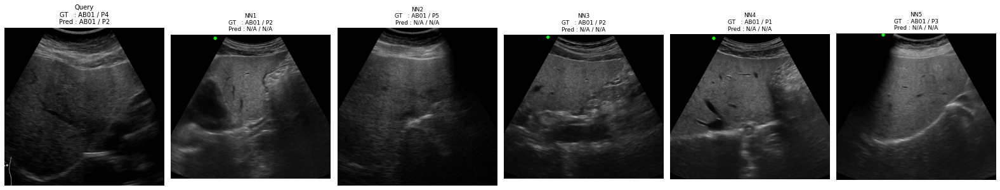


[2/11] Disease class: AB02


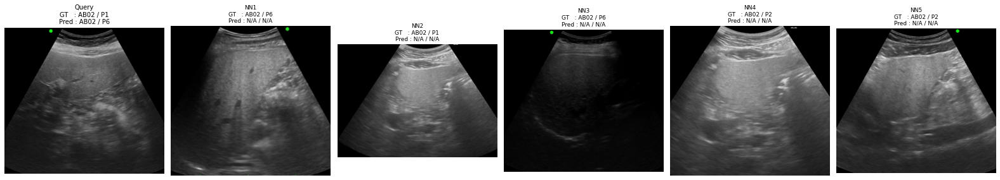


[3/11] Disease class: AB04


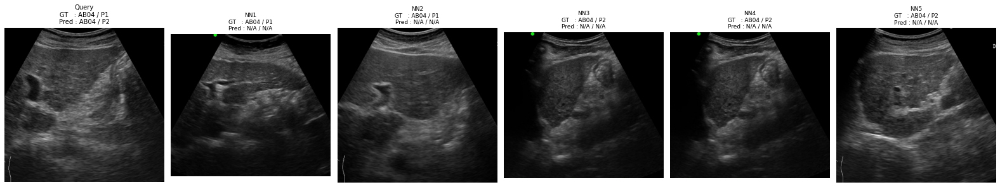


[4/11] Disease class: AB05


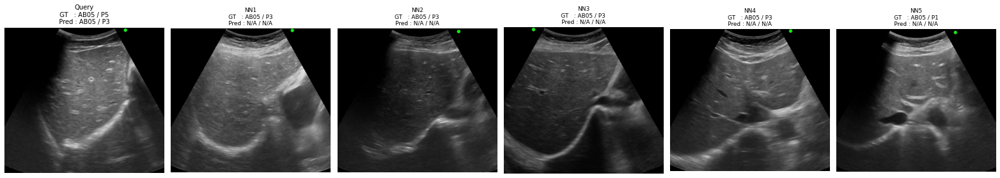


[5/11] Disease class: AB082


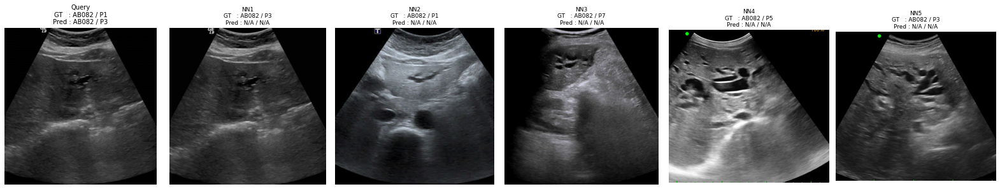


[6/11] Disease class: AB083


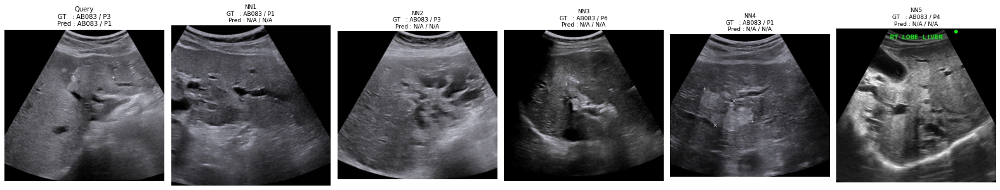


[7/11] Disease class: AB11


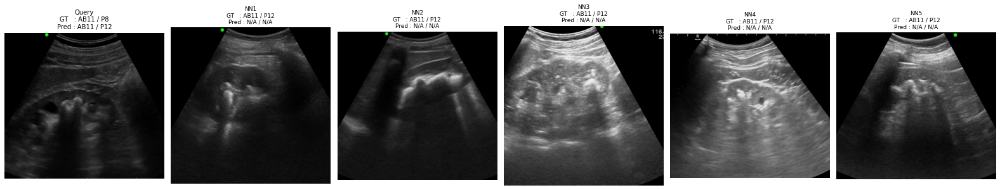


[8/11] Disease class: AB081


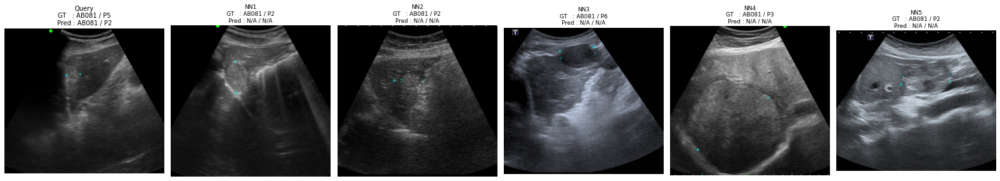


[9/11] Disease class: AB07


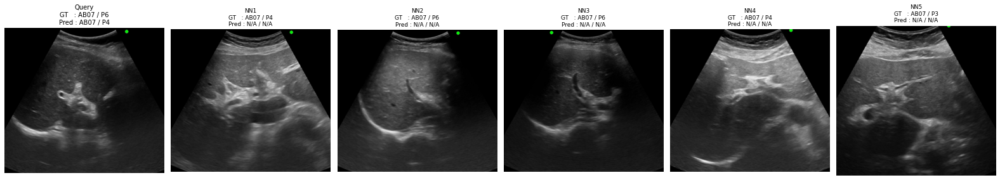


[10/11] Disease class: AB03


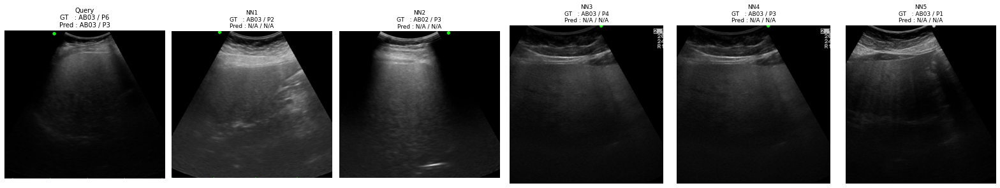


[11/11] Disease class: Normal


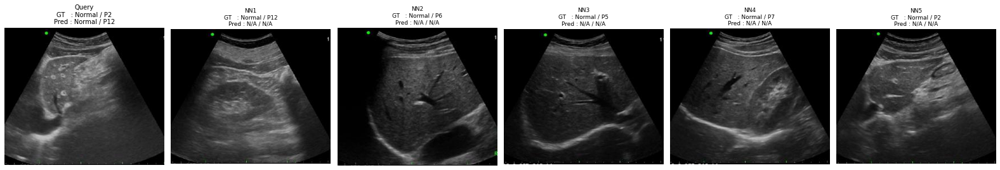

In [58]:
# =========================================================
# STEP 0: Import libraries
# =========================================================
import pandas as pd
import ast
from PIL import Image
import matplotlib.pyplot as plt


# =========================================================
# STEP 1: Load TRAIN CSV (GT + Pred ของ NN)
# =========================================================
train_csv = '/media/tohn/HDD/VISION_dataset/USAI/Data_CCA_6569.csv'
df_train = pd.read_csv(train_csv)

df_train = df_train[
    (df_train['Spilt'] == 'Train') &
    (df_train['Path Crop'].notna()) &
    (~df_train['Path Crop'].isin(['None', 'Nan']))
].drop_duplicates('Path Crop').reset_index(drop=True)

print('Train shape:', df_train.shape)


# ---- GT lookup ----
train_gt_dict = df_train.set_index('Path Crop')[
    ['Sub_class_New', 'Sub_Position_Label']
].to_dict(orient='index')

# ---- Pred lookup (ถ้ามี pred ในไฟล์นี้) ----
train_pred_dict = {}
if 'Unlearn_prob_15AB_all' in df_train.columns:
    train_pred_dict = df_train.set_index('Path Crop')[
        ['Unlearn_prob_15AB_all', 'Unlearn_prob_Sub_Position_all']
    ].to_dict(orient='index')


# =========================================================
# STEP 2: Load KNN / Unlearn results
# =========================================================
Results_Unlearn = pd.read_csv('./Evaluation_Results_KNN_Vote.csv')
print('Results_Unlearn:', Results_Unlearn.shape)


# =========================================================
# STEP 3: Select Step-3 samples
#   - Disease correct
#   - Angle incorrect
# =========================================================
step3_df = Results_Unlearn[
    (Results_Unlearn['Sub_class_New'] ==
     Results_Unlearn['KNN_Vote_Result_15AB_top5']) &
    (Results_Unlearn['Sub_Position_Label'] !=
     Results_Unlearn['KNN_Vote_Result_Sub_Position_top5'])
].reset_index(drop=True)

print('Step3 samples:', step3_df.shape)


# =========================================================
# STEP 4: Select representatives
#   🔹 ปรับ n_per_disease ได้
# =========================================================
n_per_disease = 1   # <- เปลี่ยนเป็น 3, 5 ได้

step3_rep_df = (
    step3_df
    .groupby('Sub_class_New')
    .head(n_per_disease)
    .reset_index(drop=True)
)

print('Selected samples:', step3_rep_df.shape)


# =========================================================
# STEP 5: Helper functions
# =========================================================
def parse_list(x):
    if isinstance(x, list):
        return x
    if isinstance(x, str):
        try:
            return ast.literal_eval(x)
        except:
            if ';' in x:
                return x.split(';')
            if ',' in x:
                return x.split(',')
    return []


def get_train_gt(path):
    if path in train_gt_dict:
        d = train_gt_dict[path]['Sub_class_New']
        a = train_gt_dict[path]['Sub_Position_Label']
        return d, a
    return 'Unknown', 'Unknown'


def get_train_pred(path):
    if path not in train_pred_dict:
        return 'N/A', 'N/A'

    prob_d = train_pred_dict[path]['Unlearn_prob_15AB_all']
    prob_a = train_pred_dict[path]['Unlearn_prob_Sub_Position_all']

    # parse string → list
    if isinstance(prob_d, str):
        prob_d = ast.literal_eval(prob_d)
    if isinstance(prob_a, str):
        prob_a = ast.literal_eval(prob_a)

    pred_d = prob_to_label(prob_d, DISEASE_CLASSES)
    pred_a = prob_to_label(prob_a, ANGLE_CLASSES)

    return pred_d, pred_a



# =========================================================
# STEP 6: Visualization function
# =========================================================
def visualize_step3(row, figsize=(22, 4)):

    nn_paths = parse_list(row['Path Crop_match_train_all'])[:5]

    fig, axes = plt.subplots(1, 6, figsize=figsize)

    # ---------------- Query ----------------
    try:
        img = Image.open(row['Path Crop']).convert('RGB')
        axes[0].imshow(img)
    except:
        axes[0].text(0.5, 0.5, 'Image error', ha='center')
    axes[0].axis('off')
    axes[0].set_title(
        "Query\n"
        f"GT   : {row['Sub_class_New']} / {row['Sub_Position_Label']}\n"
        f"Pred : {row['KNN_Vote_Result_15AB_top5']} / "
        f"{row['KNN_Vote_Result_Sub_Position_top5']}",
        fontsize=10
    )

    # ---------------- NN ----------------
    for i in range(5):
        ax = axes[i + 1]
        ax.axis('off')

        if i >= len(nn_paths):
            ax.set_title(f"NN{i+1}\n(no path)", fontsize=9)
            continue

        path = nn_paths[i]

        try:
            img = Image.open(path).convert('RGB')
            ax.imshow(img)
        except:
            ax.set_title(f"NN{i+1}\n(image error)", fontsize=9)
            continue

        # GT / Pred
        gt_d, gt_a = get_train_gt(path)
        pred_d, pred_a = get_train_pred(path)

        ax.set_title(
            f"NN{i+1}\n"
            f"GT   : {gt_d} / {gt_a}\n"
            f"Pred : {pred_d} / {pred_a}",
            fontsize=9
        )

    plt.tight_layout()
    plt.show()


# =========================================================
# STEP 7: Run visualization
# =========================================================
for idx, row in step3_rep_df.iterrows():
    print(f"\n[{idx+1}/{len(step3_rep_df)}] Disease class: {row['Sub_class_New']}")
    visualize_step3(row)


In [3]:
# step3_df = Results_Unlearn[
#     (Results_Unlearn['Sub_class_New'] ==
#      Results_Unlearn['KNN_Vote_Result_15AB_top5']) &
#     (Results_Unlearn['Sub_Position_Label'] ==
#      Results_Unlearn['KNN_Vote_Result_Sub_Position_top5'])
# ].reset_index(drop=True)
# step3_df

## Step 4: Visualization of Incorrect 15AB Predictions with Incorrect Viewing Angle Classification

Train shape: (5255, 27)
Results_Unlearn: (1312, 28)
Step3 samples: (622, 28)
Selected samples: (15, 28)

[1/15] Disease class: AB01


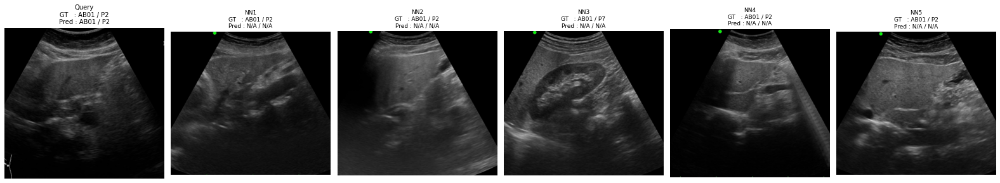


[2/15] Disease class: AB04


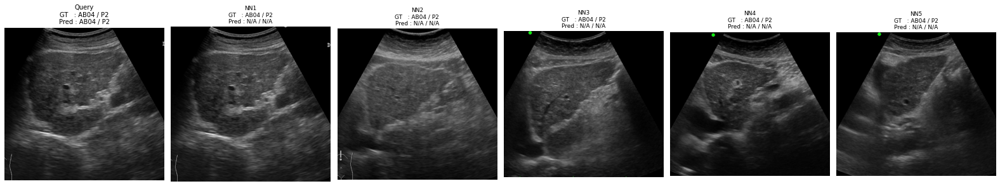


[3/15] Disease class: AB05


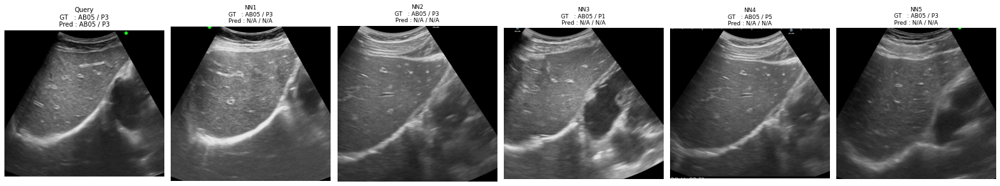


[4/15] Disease class: AB07


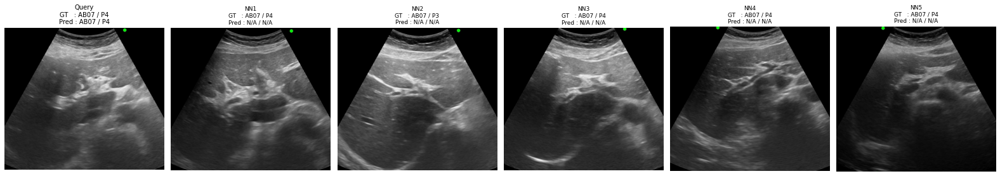


[5/15] Disease class: AB09


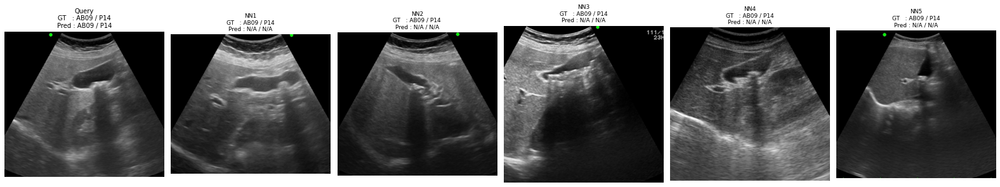


[6/15] Disease class: AB10


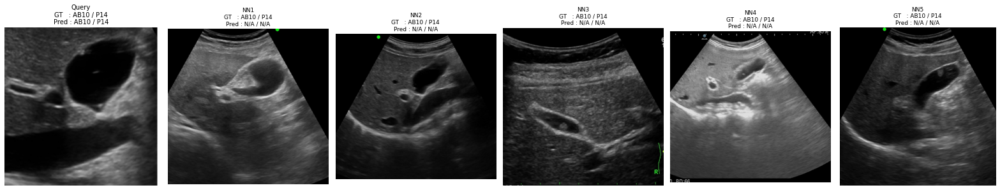


[7/15] Disease class: AB11


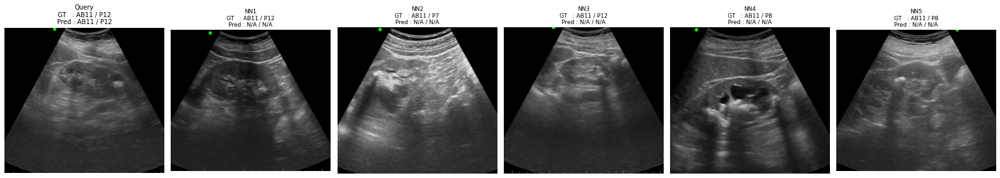


[8/15] Disease class: AB06


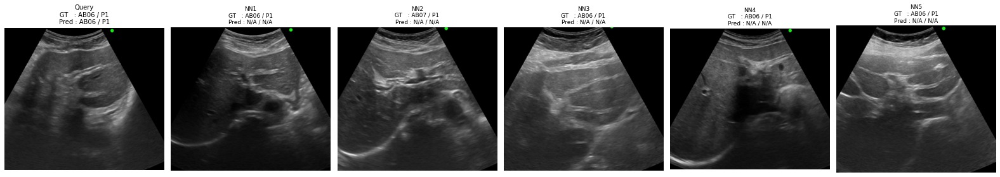


[9/15] Disease class: AB082


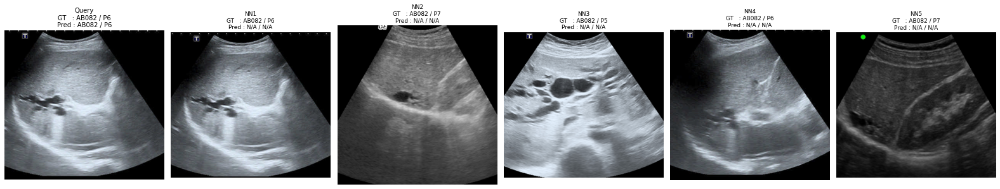


[10/15] Disease class: AB083


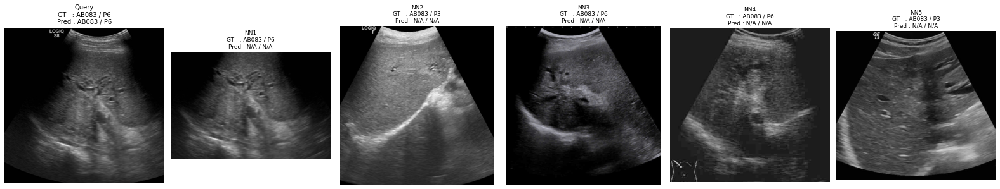


[11/15] Disease class: AB02


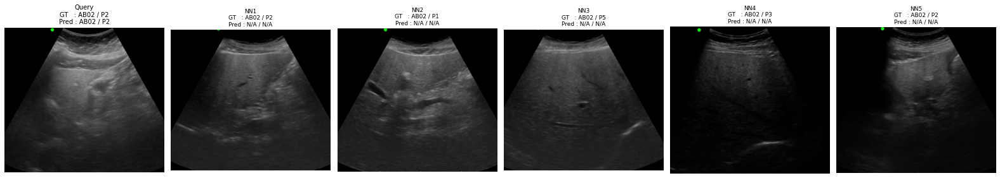


[12/15] Disease class: AB03


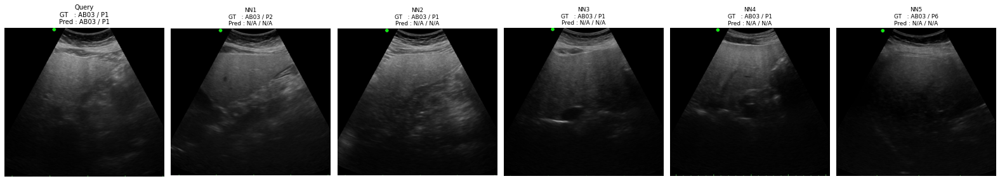


[13/15] Disease class: AB081


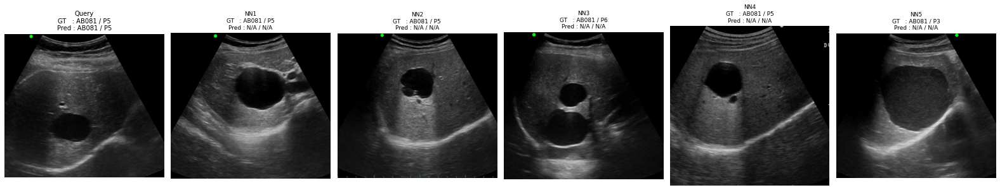


[14/15] Disease class: AB12


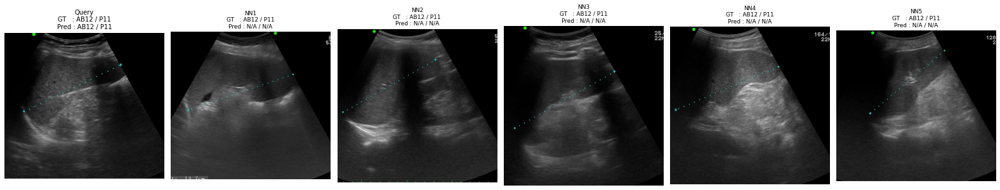


[15/15] Disease class: Normal


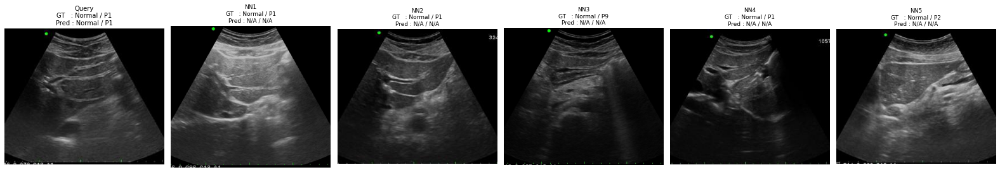

In [1]:
# =========================================================
# STEP 0: Import libraries
# =========================================================
import pandas as pd
import ast
from PIL import Image
import matplotlib.pyplot as plt


# =========================================================
# STEP 1: Load TRAIN CSV (GT + Pred ของ NN)
# =========================================================
train_csv = '/media/tohn/HDD/VISION_dataset/USAI/Data_CCA_6569.csv'
df_train = pd.read_csv(train_csv)

df_train = df_train[
    (df_train['Spilt'] == 'Train') &
    (df_train['Path Crop'].notna()) &
    (~df_train['Path Crop'].isin(['None', 'Nan']))
].drop_duplicates('Path Crop').reset_index(drop=True)

print('Train shape:', df_train.shape)


# ---- GT lookup ----
train_gt_dict = df_train.set_index('Path Crop')[
    ['Sub_class_New', 'Sub_Position_Label']
].to_dict(orient='index')

# ---- Pred lookup (ถ้ามี pred ในไฟล์นี้) ----
train_pred_dict = {}
if 'Unlearn_prob_15AB_all' in df_train.columns:
    train_pred_dict = df_train.set_index('Path Crop')[
        ['Unlearn_prob_15AB_all', 'Unlearn_prob_Sub_Position_all']
    ].to_dict(orient='index')


# =========================================================
# STEP 2: Load KNN / Unlearn results
# =========================================================
Results_Unlearn = pd.read_csv('./Evaluation_Results_KNN_Vote.csv')
print('Results_Unlearn:', Results_Unlearn.shape)


# =========================================================
# STEP 3: Select Step-3 samples
#   - Disease correct
#   - Angle incorrect
# =========================================================
step3_df = Results_Unlearn[
    (Results_Unlearn['Sub_class_New'] ==
     Results_Unlearn['KNN_Vote_Result_15AB_top5']) &
    (Results_Unlearn['Sub_Position_Label'] ==
     Results_Unlearn['KNN_Vote_Result_Sub_Position_top5'])
].reset_index(drop=True)

print('Step3 samples:', step3_df.shape)


# =========================================================
# STEP 4: Select representatives
#   🔹 ปรับ n_per_disease ได้
# =========================================================
n_per_disease = 1   # <- เปลี่ยนเป็น 3, 5 ได้

step3_rep_df = (
    step3_df
    .groupby('Sub_class_New')
    .head(n_per_disease)
    .reset_index(drop=True)
)

print('Selected samples:', step3_rep_df.shape)


# =========================================================
# STEP 5: Helper functions
# =========================================================
def parse_list(x):
    if isinstance(x, list):
        return x
    if isinstance(x, str):
        try:
            return ast.literal_eval(x)
        except:
            if ';' in x:
                return x.split(';')
            if ',' in x:
                return x.split(',')
    return []


def get_train_gt(path):
    if path in train_gt_dict:
        d = train_gt_dict[path]['Sub_class_New']
        a = train_gt_dict[path]['Sub_Position_Label']
        return d, a
    return 'Unknown', 'Unknown'


def get_train_pred(path):
    if path not in train_pred_dict:
        return 'N/A', 'N/A'

    prob_d = train_pred_dict[path]['Unlearn_prob_15AB_all']
    prob_a = train_pred_dict[path]['Unlearn_prob_Sub_Position_all']

    # parse string → list
    if isinstance(prob_d, str):
        prob_d = ast.literal_eval(prob_d)
    if isinstance(prob_a, str):
        prob_a = ast.literal_eval(prob_a)

    pred_d = prob_to_label(prob_d, DISEASE_CLASSES)
    pred_a = prob_to_label(prob_a, ANGLE_CLASSES)

    return pred_d, pred_a



# =========================================================
# STEP 6: Visualization function
# =========================================================
def visualize_step3(row, figsize=(22, 4)):

    nn_paths = parse_list(row['Path Crop_match_train_all'])[:5]

    fig, axes = plt.subplots(1, 6, figsize=figsize)

    # ---------------- Query ----------------
    try:
        img = Image.open(row['Path Crop']).convert('RGB')
        axes[0].imshow(img)
    except:
        axes[0].text(0.5, 0.5, 'Image error', ha='center')
    axes[0].axis('off')
    axes[0].set_title(
        "Query\n"
        f"GT   : {row['Sub_class_New']} / {row['Sub_Position_Label']}\n"
        f"Pred : {row['KNN_Vote_Result_15AB_top5']} / "
        f"{row['KNN_Vote_Result_Sub_Position_top5']}",
        fontsize=10
    )

    # ---------------- NN ----------------
    for i in range(5):
        ax = axes[i + 1]
        ax.axis('off')

        if i >= len(nn_paths):
            ax.set_title(f"NN{i+1}\n(no path)", fontsize=9)
            continue

        path = nn_paths[i]

        try:
            img = Image.open(path).convert('RGB')
            ax.imshow(img)
        except:
            ax.set_title(f"NN{i+1}\n(image error)", fontsize=9)
            continue

        # GT / Pred
        gt_d, gt_a = get_train_gt(path)
        pred_d, pred_a = get_train_pred(path)

        ax.set_title(
            f"NN{i+1}\n"
            f"GT   : {gt_d} / {gt_a}\n"
            f"Pred : {pred_d} / {pred_a}",
            fontsize=9
        )

    plt.tight_layout()
    plt.show()


# =========================================================
# STEP 7: Run visualization
# =========================================================
for idx, row in step3_rep_df.iterrows():
    print(f"\n[{idx+1}/{len(step3_rep_df)}] Disease class: {row['Sub_class_New']}")
    visualize_step3(row)


Train shape: (5255, 27)
Results_Unlearn shape: (1312, 28)
Step3 samples: (550, 28)
Selected samples: (11, 28)

[1/11] Disease class: AB01


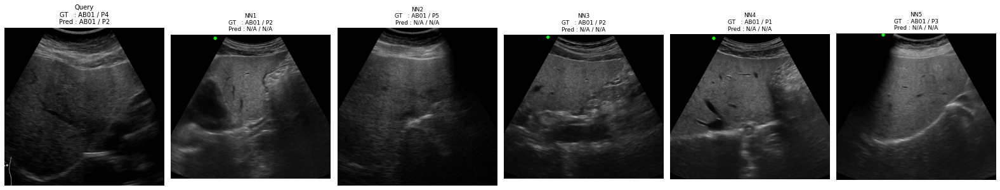


[2/11] Disease class: AB02


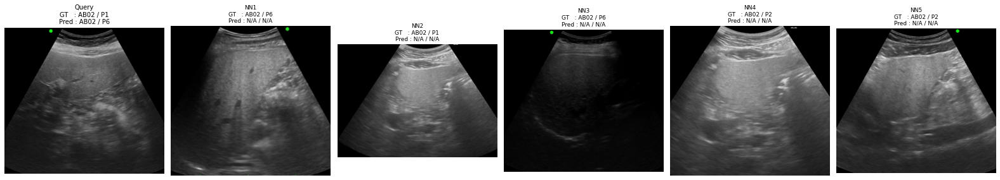


[3/11] Disease class: AB04


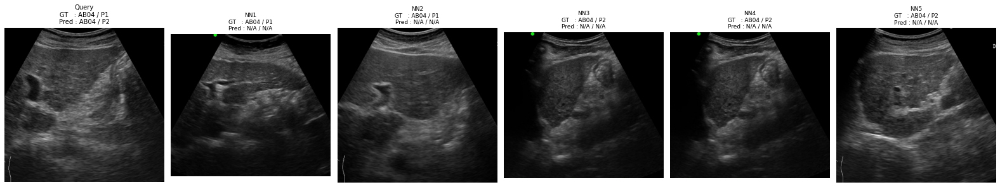


[4/11] Disease class: AB05


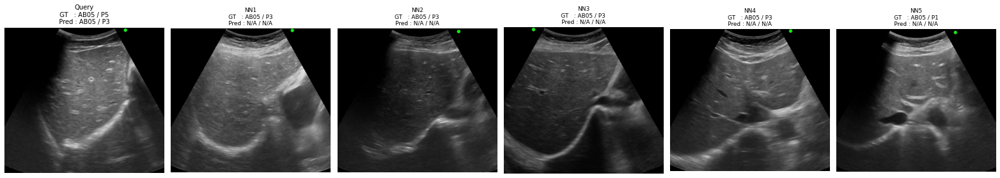


[5/11] Disease class: AB082


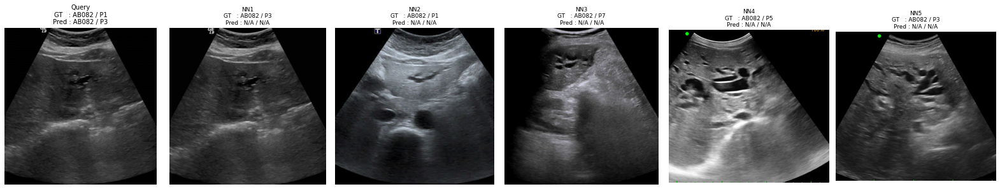


[6/11] Disease class: AB083


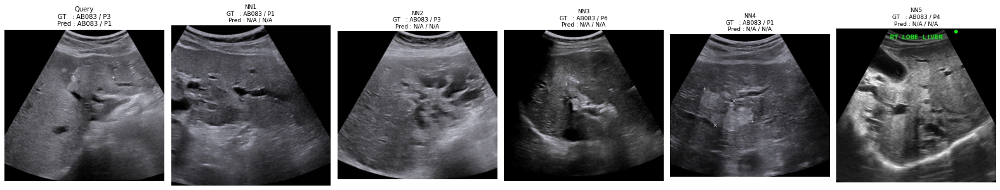


[7/11] Disease class: AB11


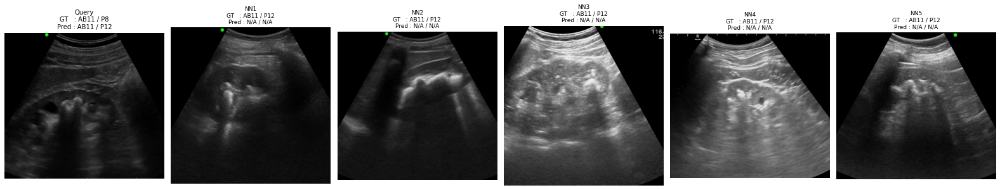


[8/11] Disease class: AB081


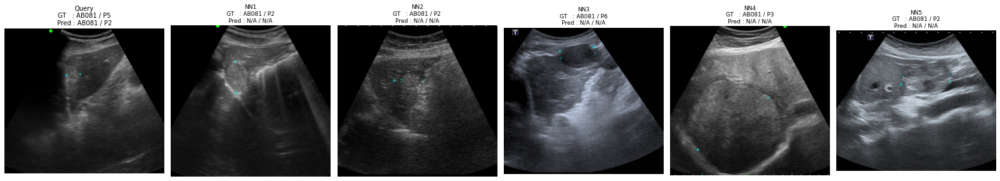


[9/11] Disease class: AB07


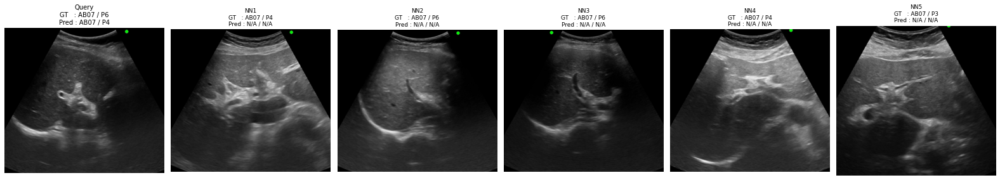


[10/11] Disease class: AB03


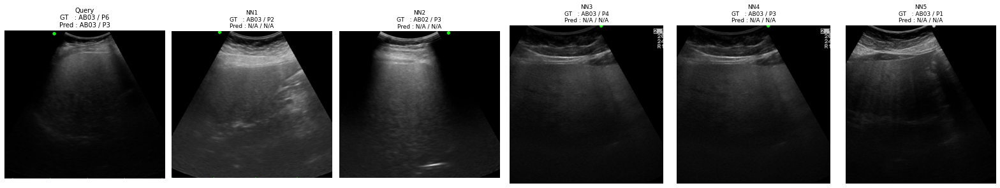


[11/11] Disease class: Normal


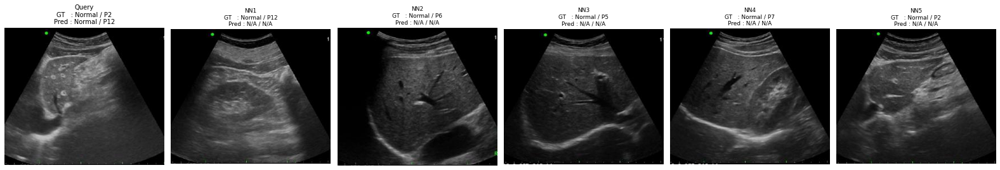

In [59]:
# =========================================================
# STEP 0: Import libraries
# =========================================================
import pandas as pd
import ast
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt


# =========================================================
# STEP 1: Load TRAIN CSV (GT ของ NN)
# =========================================================
train_csv = '/media/tohn/HDD/VISION_dataset/USAI/Data_CCA_6569.csv'
df_train = pd.read_csv(train_csv)

df_train = df_train[
    (df_train['Spilt'] == 'Train') &
    (df_train['Path Crop'].notna()) &
    (~df_train['Path Crop'].isin(['None', 'Nan']))
].drop_duplicates('Path Crop').reset_index(drop=True)

print('Train shape:', df_train.shape)

# ---- GT lookup ----
train_gt_dict = df_train.set_index('Path Crop')[
    ['Sub_class_New', 'Sub_Position_Label']
].to_dict(orient='index')


# =========================================================
# STEP 2: Load KNN / Unlearn results
# =========================================================
Results_Unlearn = pd.read_csv('./Evaluation_Results_KNN_Vote.csv')
print('Results_Unlearn shape:', Results_Unlearn.shape)

# ---- NN pred lookup (ใช้ไฟล์นี้เท่านั้น) ----
nn_pred_dict = Results_Unlearn.set_index('Path Crop')[
    ['Unlearn_prob_15AB_all', 'Unlearn_prob_Sub_Position_all']
].to_dict(orient='index')


# =========================================================
# STEP 3: Select Step-3 samples
#   - Disease correct
#   - Angle incorrect
# =========================================================
step3_df = Results_Unlearn[
    (Results_Unlearn['Sub_class_New'] ==
     Results_Unlearn['KNN_Vote_Result_15AB_top5']) &
    (Results_Unlearn['Sub_Position_Label'] !=
     Results_Unlearn['KNN_Vote_Result_Sub_Position_top5'])
].reset_index(drop=True)

print('Step3 samples:', step3_df.shape)


# =========================================================
# STEP 4: Select representatives
# =========================================================
n_per_disease = 1   # เปลี่ยนเป็น 3 หรือ 5 ได้

step3_rep_df = (
    step3_df
    .groupby('Sub_class_New')
    .head(n_per_disease)
    .reset_index(drop=True)
)

print('Selected samples:', step3_rep_df.shape)


# =========================================================
# STEP 5: Class order (ต้องตรงกับตอน train)
# =========================================================
DISEASE_CLASSES = [
    'AB01','AB02','AB03','AB04','AB05',
    'AB06','AB07','AB08','AB09','AB10','AB11'
]

ANGLE_CLASSES = ['P1','P2','P3','P4','P5','P6']


# =========================================================
# STEP 6: Helper functions
# =========================================================
def parse_list(x):
    if isinstance(x, list):
        return x
    if isinstance(x, str):
        try:
            return ast.literal_eval(x)
        except:
            if ';' in x:
                return x.split(';')
            if ',' in x:
                return x.split(',')
    return []


def prob_to_label(prob_list, class_list):
    if not isinstance(prob_list, (list, tuple)):
        return 'N/A'
    idx = int(np.argmax(prob_list))
    return class_list[idx]


def get_train_gt(path):
    if path in train_gt_dict:
        d = train_gt_dict[path]['Sub_class_New']
        a = train_gt_dict[path]['Sub_Position_Label']
        return d, a
    return 'Unknown', 'Unknown'


def get_nn_pred(path):
    if path not in nn_pred_dict:
        return 'N/A', 'N/A'

    prob_d = nn_pred_dict[path]['Unlearn_prob_15AB_all']
    prob_a = nn_pred_dict[path]['Unlearn_prob_Sub_Position_all']

    if isinstance(prob_d, str):
        prob_d = ast.literal_eval(prob_d)
    if isinstance(prob_a, str):
        prob_a = ast.literal_eval(prob_a)

    pred_d = prob_to_label(prob_d, DISEASE_CLASSES)
    pred_a = prob_to_label(prob_a, ANGLE_CLASSES)

    return pred_d, pred_a


# =========================================================
# STEP 7: Visualization function
# =========================================================
def visualize_step3(row, figsize=(22, 4)):

    nn_paths = parse_list(row['Path Crop_match_train_all'])[:5]

    fig, axes = plt.subplots(1, 6, figsize=figsize)

    # ---------------- Query ----------------
    try:
        img = Image.open(row['Path Crop']).convert('RGB')
        axes[0].imshow(img)
    except:
        axes[0].text(0.5, 0.5, 'Image error', ha='center')

    axes[0].axis('off')
    axes[0].set_title(
        "Query\n"
        f"GT   : {row['Sub_class_New']} / {row['Sub_Position_Label']}\n"
        f"Pred : {row['KNN_Vote_Result_15AB_top5']} / "
        f"{row['KNN_Vote_Result_Sub_Position_top5']}",
        fontsize=10
    )

    # ---------------- NN ----------------
    for i in range(5):
        ax = axes[i + 1]
        ax.axis('off')

        if i >= len(nn_paths):
            ax.set_title(f"NN{i+1}\n(no path)", fontsize=9)
            continue

        path = nn_paths[i]

        try:
            img = Image.open(path).convert('RGB')
            ax.imshow(img)
        except:
            ax.set_title(f"NN{i+1}\n(image error)", fontsize=9)
            continue

        gt_d, gt_a = get_train_gt(path)
        pred_d, pred_a = get_nn_pred(path)

        ax.set_title(
            f"NN{i+1}\n"
            f"GT   : {gt_d} / {gt_a}\n"
            f"Pred : {pred_d} / {pred_a}",
            fontsize=9
        )

    plt.tight_layout()
    plt.show()


# =========================================================
# STEP 8: Run visualization
# =========================================================
for idx, row in step3_rep_df.iterrows():
    print(f"\n[{idx+1}/{len(step3_rep_df)}] Disease class: {row['Sub_class_New']}")
    visualize_step3(row)


In [12]:
# 1️⃣ Identify samples: disease ถูก แต่ angle ผิด
# disease = 15AB
# angle   = Sub_Position

mask_correct_disease_wrong_angle = (
    (Results_Unlearn['Sub_class_New'] == Results_Unlearn['KNN_Vote_Result_15AB_top5']) &
    (Results_Unlearn['Sub_Position_Label'] != Results_Unlearn['KNN_Vote_Result_Sub_Position_top5'])
)

df_cd_wa = Results_Unlearn[mask_correct_disease_wrong_angle].reset_index(drop=True)

print("Total samples (Correct disease, Wrong angle):", len(df_cd_wa))


Total samples (Correct disease, Wrong angle): 550


In [13]:
# 2️⃣ Select one representative sample per disease class
# เลือก 1 sample ต่อ disease class
df_rep = (
    df_cd_wa
    .groupby('Sub_class_New', as_index=False)
    .first()
)

print("Representative samples:", len(df_rep))


Representative samples: 11


In [17]:
# 3️⃣ Helper: parse top-5 NN paths from Path Crop_match_train_all

import ast

def parse_top5_paths(x):
    """
    Convert Path Crop_match_train_all to Python list of paths
    """
    if isinstance(x, list):
        return x[:5]

    if isinstance(x, str):
        # case: stringified list
        try:
            parsed = ast.literal_eval(x)
            if isinstance(parsed, list):
                return parsed[:5]
        except:
            pass

        # case: delimiter-separated string
        if ';' in x:
            return x.split(';')[:5]
        if ',' in x:
            return x.split(',')[:5]

    return []

In [21]:
# Helper: parse list (ใช้ซ้ำได้ทุกคอลัมน์)
import ast

def parse_list(x):
    if isinstance(x, list):
        return x
    if isinstance(x, str):
        try:
            return ast.literal_eval(x)
        except:
            if ';' in x:
                return x.split(';')
            if ',' in x:
                return x.split(',')
    return []


In [40]:
# # 4️⃣ Visualization function (Query + Top-5 Neighbors)

# import matplotlib.pyplot as plt
# from PIL import Image

# def visualize_query_and_neighbors(row, figsize=(18, 4)):

#     nn_paths = parse_top5_paths(row['Path Crop_match_train_all'])

#     fig, axes = plt.subplots(1, 6, figsize=figsize)

#     # -------- Query image --------
#     query_img = Image.open(row['Path Crop']).convert('RGB')
#     axes[0].imshow(query_img)
#     axes[0].axis('off')
#     axes[0].set_title(
#         f"Query\n"
#         f"GT: {row['Sub_class_New']} / {row['Sub_Position_Label']}\n"
#         f"Pred: {row['KNN_Vote_Result_15AB_top5']} / "
#         f"{row['KNN_Vote_Result_Sub_Position_top5']}",
#         fontsize=9
#     )

#     # -------- Top-5 NN images --------
#     for i in range(5):
#         ax = axes[i + 1]
#         ax.axis('off')

#         if i < len(nn_paths):
#             try:
#                 img = Image.open(nn_paths[i]).convert('RGB')
#                 ax.imshow(img)
#                 ax.set_title(f"NN{i+1}", fontsize=9)
#             except:
#                 ax.set_title(f"NN{i+1}\n(load error)", fontsize=8)
#         else:
#             ax.set_title(f"NN{i+1}\n(missing)", fontsize=8)

#     plt.tight_layout()
#     plt.show()


In [39]:
# for _, row in df_rep.iterrows():
#     print(f"\nDisease class: {row['Sub_class_New']}")
#     visualize_query_and_neighbors(row)


In [42]:
import pandas as pd
train = '/media/tohn/HDD/VISION_dataset/USAI/Data_CCA_6569.csv'
# test = '/home/yupaporn/codes/USAI/Testdf.csv'
df0 = pd.read_csv (train)

print(df0 .shape)
dataframe = df0[(df0['Path Crop']!='None' )&(df0['Path Crop']!='Nan')]
dataframe = df0[df0['Spilt'] == 'Train']
dataframe = dataframe.reset_index(drop=True)
print(dataframe.shape)
# print('Normal: ',dataframe[dataframe['Class']=='Normal'].shape)
# print('Abnormal: ',dataframe[dataframe['Class']=='Abnormal'].shape)

(6569, 27)
(5257, 27)


In [37]:
# Visualization function (Query + NN พร้อม label ครบ)


import matplotlib.pyplot as plt
from PIL import Image

def visualize_query_and_neighbors_with_labels(row, figsize=(20, 4)):

    # -------- Parse NN info --------
    nn_paths   = parse_list(row['Path Crop_match_train_all'])[:5]
    nn_disease = parse_list(row['Unlearn_prob_15AB_all'])[:5]
    nn_angle   = parse_list(row['Unlearn_prob_Sub_Position_all'])[:5]

    fig, axes = plt.subplots(1, 6, figsize=figsize)

    # ================= Query image =================
    query_img = Image.open(row['Path Crop']).convert('RGB')
    axes[0].imshow(query_img)
    axes[0].axis('off')
    axes[0].set_title(
        f"Query\n"
        f"GT: {row['Sub_class_New']} / {row['Sub_Position_Label']}\n"
        f"Pred: {row['KNN_Vote_Result_15AB_top5']} / "
        f"{row['KNN_Vote_Result_Sub_Position_top5']}",
        fontsize=9
    )

    # ================= NN images =================
    for i in range(5):
        ax = axes[i + 1]
        ax.axis('off')

        if i < len(nn_paths):
            try:
                img = Image.open(nn_paths[i]).convert('RGB')
                ax.imshow(img)

                title = (
                    f"NN{i+1}\n"
                    f"Disease Pred: {nn_disease[i]}\n"
                    f"Angle Pred: {nn_angle[i]}"
                )
                ax.set_title(title, fontsize=9)

            except:
                ax.set_title(f"NN{i+1}\n(load error)", fontsize=8)
        else:
            ax.set_title(f"NN{i+1}\n(missing)", fontsize=8)

    plt.tight_layout()
    plt.show()




Disease class: AB01


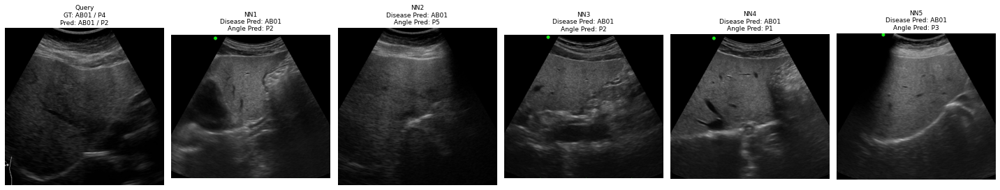


Disease class: AB02


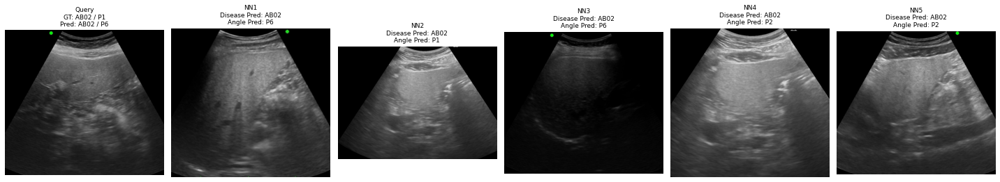


Disease class: AB03


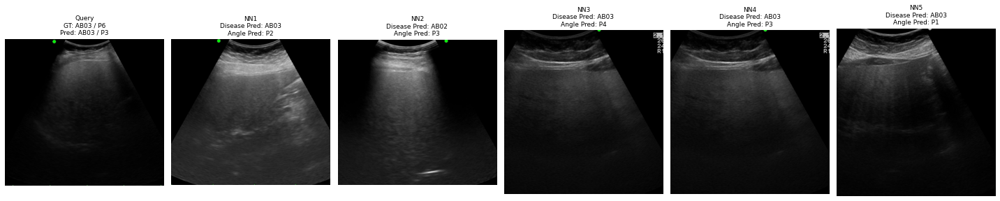


Disease class: AB04


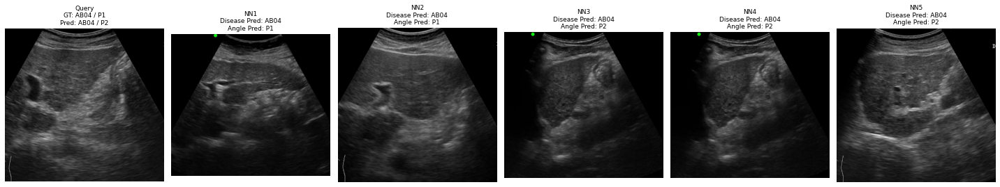


Disease class: AB05


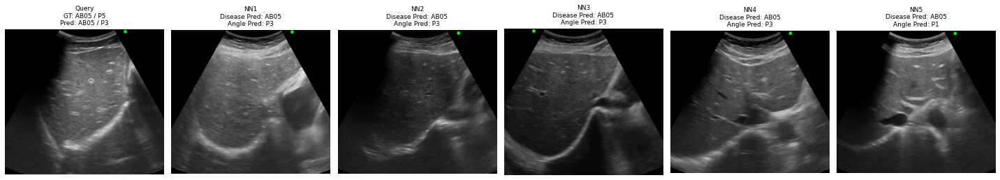


Disease class: AB07


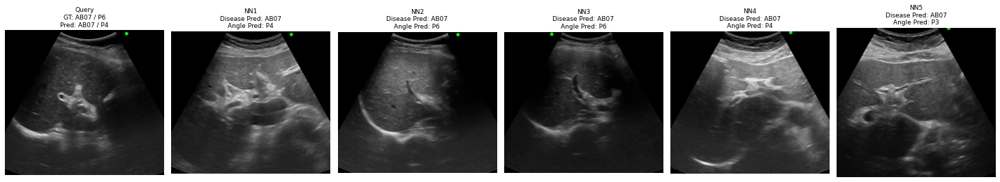


Disease class: AB081


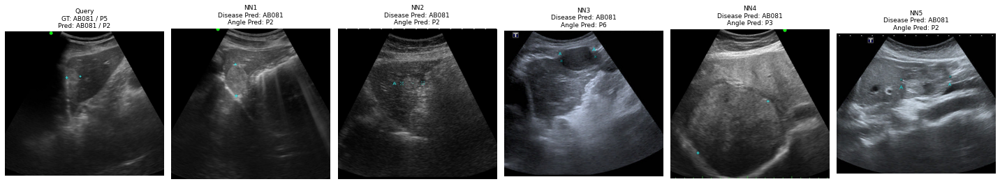


Disease class: AB082


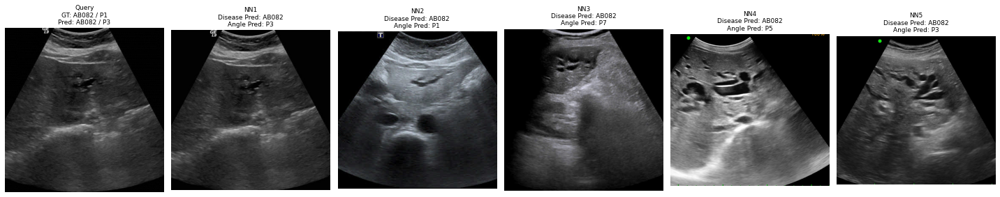


Disease class: AB083


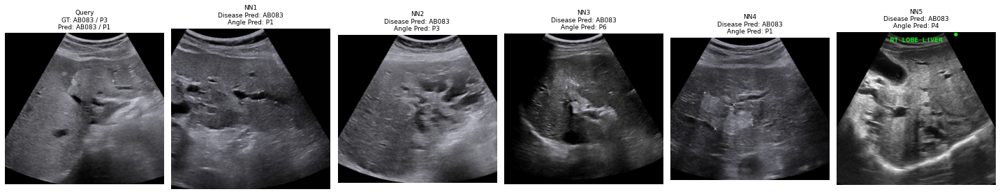


Disease class: AB11


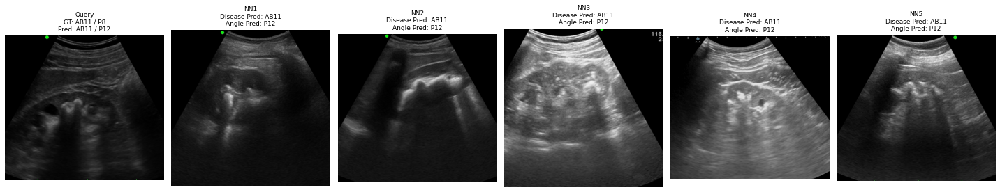


Disease class: Normal


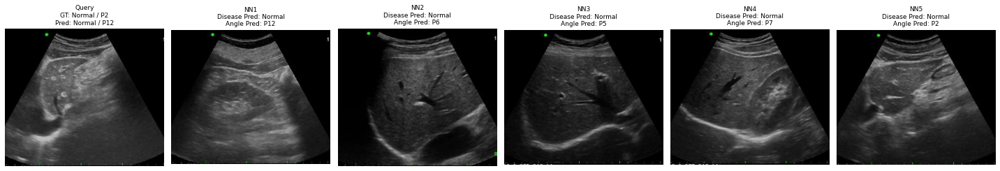

In [38]:
# Run Step 3 (1 sample ต่อ 1 disease class)
for _, row in df_rep.iterrows():
    print(f"\nDisease class: {row['Sub_class_New']}")
    visualize_query_and_neighbors_with_labels(row)


(5257, 27)
Before: (5257, 27)
After : (5255, 27)

Disease class: AB01


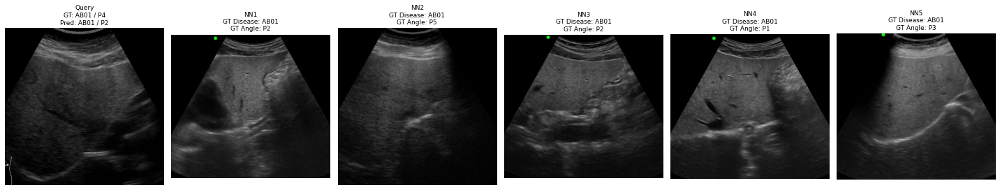


Disease class: AB02


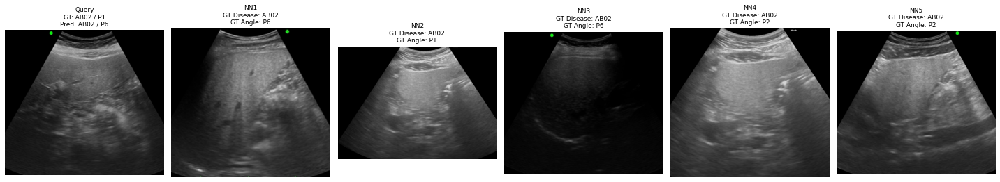


Disease class: AB03


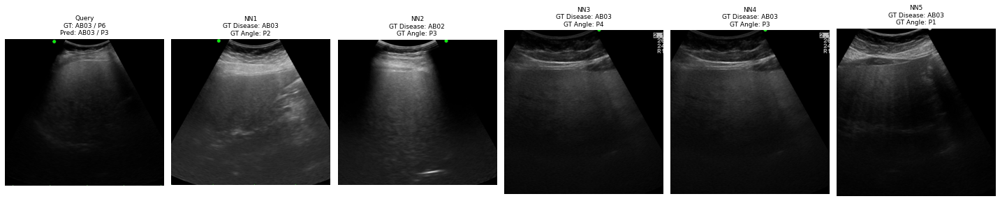


Disease class: AB04


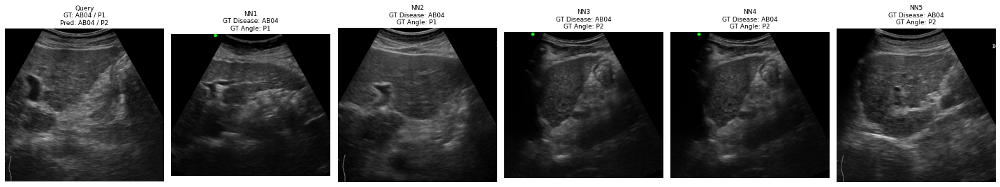


Disease class: AB05


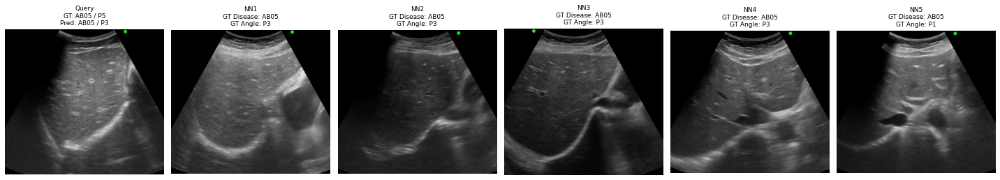


Disease class: AB07


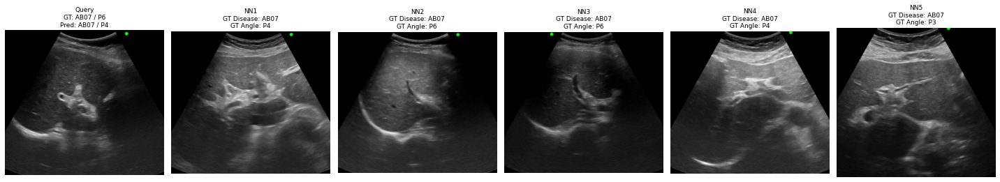


Disease class: AB081


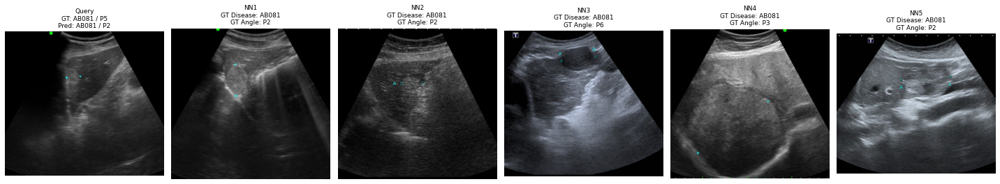


Disease class: AB082


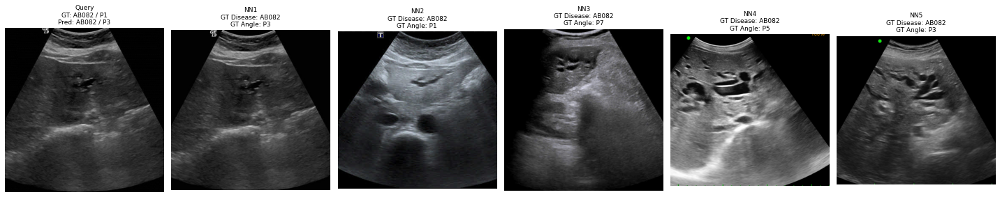


Disease class: AB083


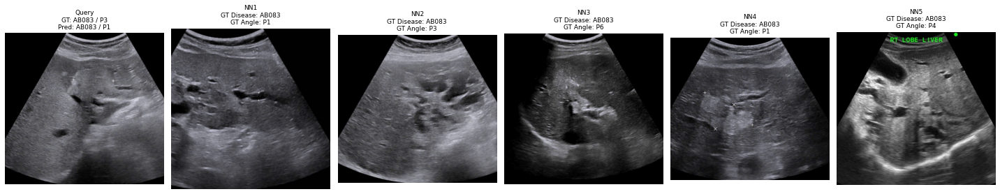


Disease class: AB11


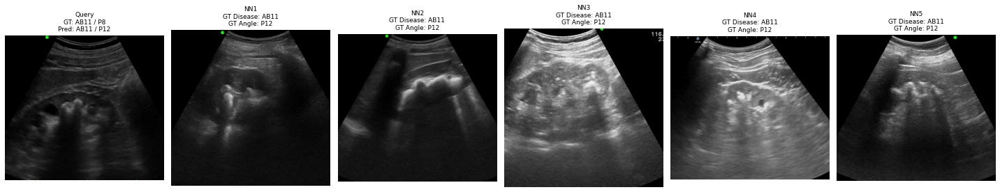


Disease class: Normal


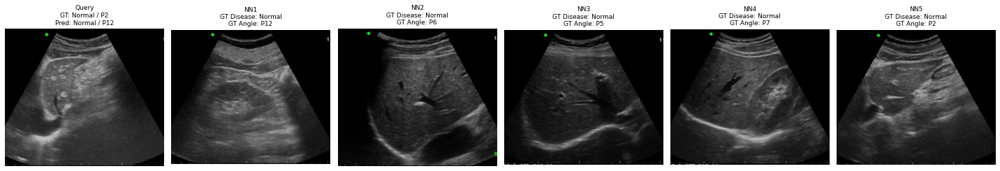

In [48]:
# สร้าง lookup table จาก Train CSV แล้วใช้ path ไปดึง GT label
# 1️⃣ เตรียม Train GT lookup table

import pandas as pd

train_csv = '/media/tohn/HDD/VISION_dataset/USAI/Data_CCA_6569.csv'
df_train = pd.read_csv(train_csv)

# ใช้เฉพาะ Train และ path ที่ valid
df_train = df_train[
    (df_train['Spilt'] == 'Train') &
    (df_train['Path Crop'].notna()) &
    (df_train['Path Crop'] != 'None') &
    (df_train['Path Crop'] != 'Nan')
].reset_index(drop=True)

print(df_train.shape)

# สร้าง dictionary สำหรับ lookup (เร็วและ clean มาก)
df_train_unique = (
    df_train
    .drop_duplicates(subset='Path Crop', keep='first')
    .reset_index(drop=True)
)

print("Before:", df_train.shape)
print("After :", df_train_unique.shape)
train_gt_dict = df_train_unique.set_index('Path Crop')[
    ['Sub_class_New', 'Sub_Position_Label']
].to_dict(orient='index')



# 2️⃣ Helper function: ดึง GT จาก path
def get_train_gt(path, gt_dict):
    if path in gt_dict:
        return gt_dict[path]['Sub_class_New'], gt_dict[path]['Sub_Position_Label']
    else:
        return 'Unknown', 'Unknown'
# 1️⃣ Helper functions (parse + lookup)
import ast

def parse_list(x):
    if isinstance(x, list):
        return x
    if isinstance(x, str):
        try:
            return ast.literal_eval(x)
        except:
            if ';' in x:
                return x.split(';')
            if ',' in x:
                return x.split(',')
    return []

def get_train_gt(path, gt_dict):
    if path in gt_dict:
        return gt_dict[path]['Sub_class_New'], gt_dict[path]['Sub_Position_Label']
    else:
        return 'Unknown', 'Unknown'

    
# 3️⃣ Visualization (Query + NN พร้อม GT ของ NN จาก Train CSV)
from PIL import Image
import matplotlib.pyplot as plt
import ast

def parse_list(x):
    if isinstance(x, list):
        return x
    if isinstance(x, str):
        try:
            return ast.literal_eval(x)
        except:
            if ';' in x:
                return x.split(';')
            if ',' in x:
                return x.split(',')
    return []
def visualize_query_and_neighbors_with_GT(row, train_gt_dict, figsize=(20, 4)):

    nn_paths = parse_list(row['Path Crop_match_train_all'])[:5]

    fig, axes = plt.subplots(1, 6, figsize=figsize)

    # ================= Query =================
    query_img = Image.open(row['Path Crop']).convert('RGB')
    axes[0].imshow(query_img)
    axes[0].axis('off')
    axes[0].set_title(
        f"Query\n"
        f"GT: {row['Sub_class_New']} / {row['Sub_Position_Label']}\n"
        f"Pred: {row['KNN_Vote_Result_15AB_top5']} / "
        f"{row['KNN_Vote_Result_Sub_Position_top5']}",
        fontsize=9
    )

    # ================= NN =================
    for i in range(5):
        ax = axes[i + 1]
        ax.axis('off')

        if i >= len(nn_paths):
            ax.set_title(f"NN{i+1}\n(no path)", fontsize=8)
            continue

        path = nn_paths[i]

        # load image
        try:
            img = Image.open(path).convert('RGB')
            ax.imshow(img)
        except:
            ax.set_title(f"NN{i+1}\n(image error)", fontsize=8)
            continue

        # get GT from train CSV
        gt_disease, gt_angle = get_train_gt(path, train_gt_dict)

        ax.set_title(
            f"NN{i+1}\n"
            f"GT Disease: {gt_disease}\n"
            f"GT Angle: {gt_angle}",
            fontsize=9
        )

    plt.tight_layout()
    plt.show()

# 4️⃣ ใช้งานกับ Step 3 representative rows
for _, row in step3_rep_df.iterrows():
    print(f"\nDisease class: {row['Sub_class_New']}")
    visualize_query_and_neighbors_with_GT(row, train_gt_dict)


(5255, 27)
Step3 samples: (550, 28)
Disease classes: (11, 28)

Disease class: AB01


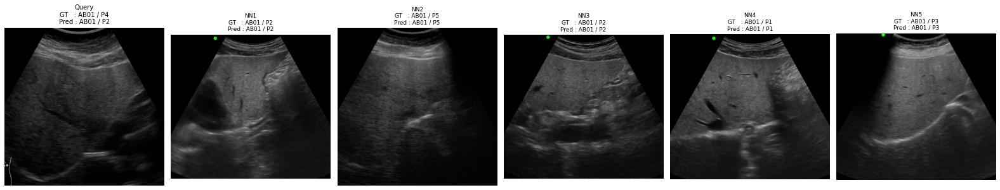


Disease class: AB02


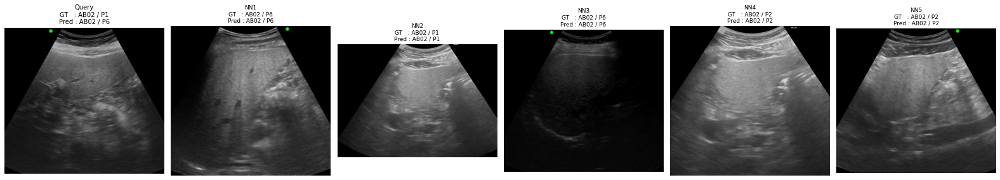


Disease class: AB03


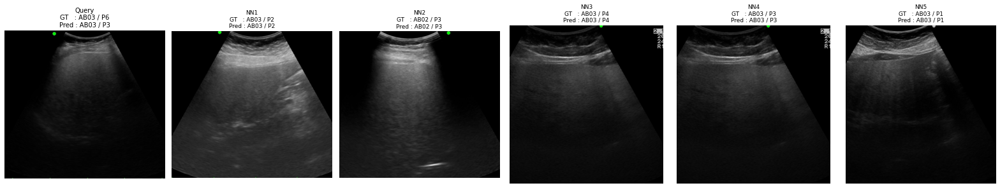


Disease class: AB04


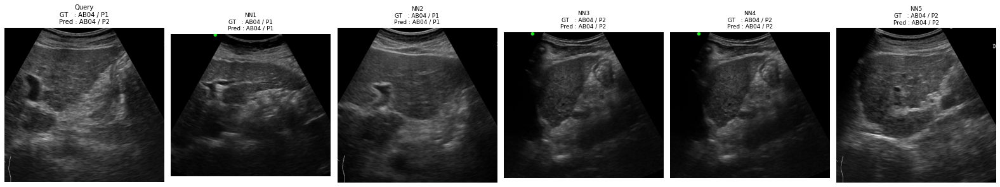


Disease class: AB05


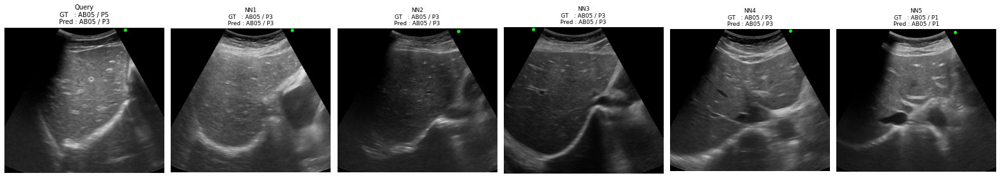


Disease class: AB07


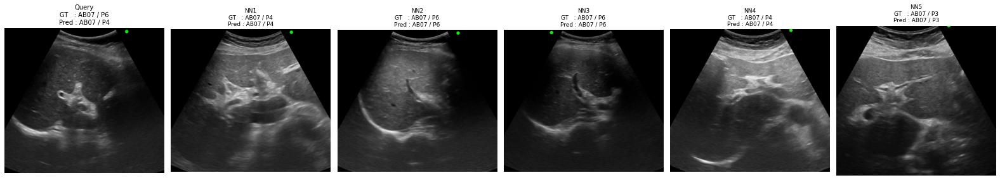


Disease class: AB081


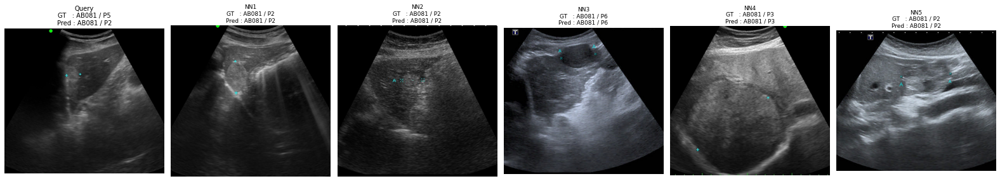


Disease class: AB082


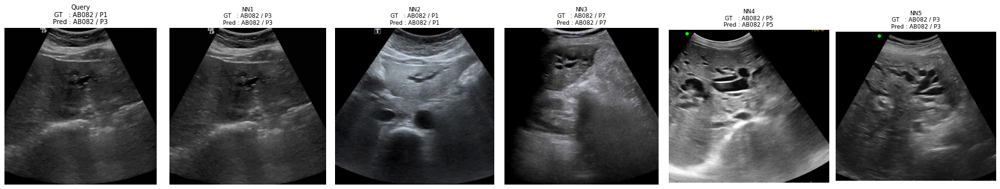


Disease class: AB083


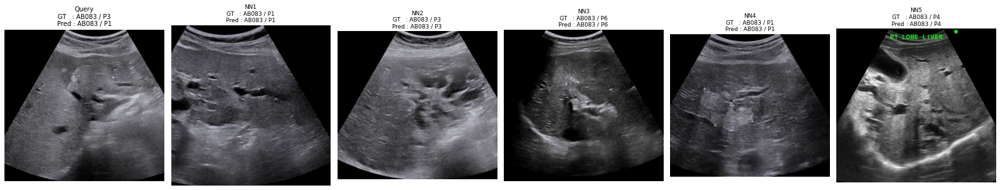


Disease class: AB11


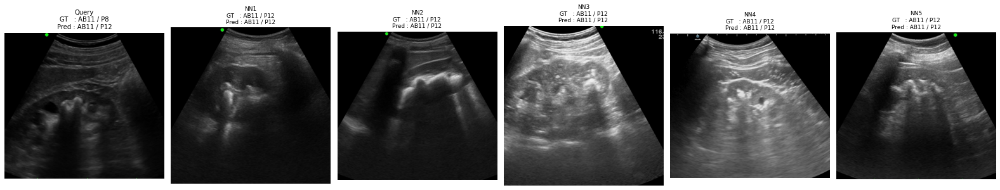


Disease class: Normal


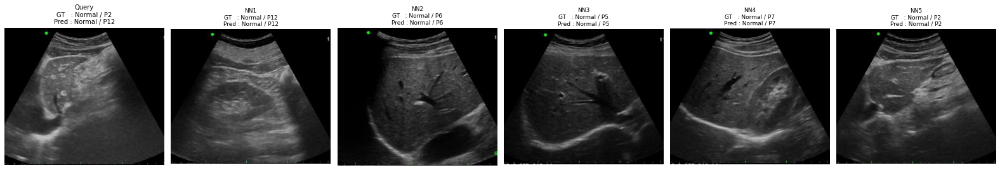

In [55]:
# 🔹 STEP 0: Import library ที่จำเป็น
import pandas as pd
import ast
from PIL import Image
import matplotlib.pyplot as plt

# 🔹 STEP 1: โหลด Train CSV (GT ของ NN)
train_csv = '/media/tohn/HDD/VISION_dataset/USAI/Data_CCA_6569.csv'
df_train = pd.read_csv(train_csv)

# ใช้เฉพาะ Train + path ที่ valid
df_train = df_train[
    (df_train['Spilt'] == 'Train') &
    (df_train['Path Crop'].notna()) &
    (df_train['Path Crop'] != 'None') &
    (df_train['Path Crop'] != 'Nan')
]

# ทำให้ Path Crop unique
df_train = df_train.drop_duplicates(subset='Path Crop').reset_index(drop=True)

print(df_train.shape)

# 🔹 STEP 2: สร้าง GT lookup dictionary (หัวใจของงานนี้)
train_gt_dict = df_train.set_index('Path Crop')[
    ['Sub_class_New', 'Sub_Position_Label']
].to_dict(orient='index')


# 🔹 STEP 3: โหลดผล KNN / Unlearn (Results_Unlearn)
Results_Unlearn = pd.read_csv('./Evaluation_Results_KNN_Vote.csv')

# 🔹 STEP 4: เลือกเฉพาะ Step 3 samples
# (Disease ถูก แต่ Angle ผิด)
step3_df = Results_Unlearn[
    (Results_Unlearn['Sub_class_New'] == Results_Unlearn['KNN_Vote_Result_15AB_top5']) &
    (Results_Unlearn['Sub_Position_Label'] != Results_Unlearn['KNN_Vote_Result_Sub_Position_top5'])
].reset_index(drop=True)

print("Step3 samples:", step3_df.shape)

# 🔹 STEP 5: เลือก 1 ตัวแทนต่อ disease class
step3_rep_df = step3_df.groupby('Sub_class_New', as_index=False).first()
print("Disease classes:", step3_rep_df.shape)


# 🔹 STEP 6: Helper functions (สำคัญ)

# 6.1 parse list จาก CSV
def parse_list(x):
    if isinstance(x, list):
        return x
    if isinstance(x, str):
        try:
            return ast.literal_eval(x)
        except:
            if ';' in x:
                return x.split(';')
            if ',' in x:
                return x.split(',')
    return []

# 6.2 lookup GT จาก train
def get_train_gt(path):
    if path in train_gt_dict:
        return train_gt_dict[path]['Sub_class_New'], train_gt_dict[path]['Sub_Position_Label']
    return 'Unknown', 'Unknown'

# 🔹 STEP 7: Visualization function (Figure แบบที่คุณต้องการ)

# ✅ Query + NN (GT + Pred ครบ)
# ✅ รูปแบบ text ตรงตาม screenshot

def visualize_step3(row, figsize=(22, 4)):

    nn_paths = parse_list(row['Path Crop_match_train_all'])[:5]
    # nn_pred_d = parse_list(row['Unlearn_pred_15AB_top5'])[:5]
    # nn_pred_a = parse_list(row['Unlearn_pred_Sub_Position_top5'])[:5]
    nn_pred_d = parse_list(row['Unlearn_prob_15AB_all'])[:5]
    nn_pred_a   = parse_list(row['Unlearn_prob_Sub_Position_all'])[:5]

    fig, axes = plt.subplots(1, 6, figsize=figsize)

    # ===== Query =====
    query_img = Image.open(row['Path Crop']).convert('RGB')
    axes[0].imshow(query_img)
    axes[0].axis('off')
    axes[0].set_title(
        "Query\n"
        f"GT   : {row['Sub_class_New']} / {row['Sub_Position_Label']}\n"
        f"Pred : {row['KNN_Vote_Result_15AB_top5']} / "
        f"{row['KNN_Vote_Result_Sub_Position_top5']}",
        fontsize=10
    )

    # ===== NN =====
    for i in range(5):
        ax = axes[i + 1]
        ax.axis('off')

        if i >= len(nn_paths):
            ax.set_title(f"NN{i+1}\n(no path)", fontsize=9)
            continue

        path = nn_paths[i]

        # load image
        try:
            img = Image.open(path).convert('RGB')
            ax.imshow(img)
        except:
            ax.set_title(f"NN{i+1}\n(image error)", fontsize=9)
            continue

        # GT
        gt_d, gt_a = get_train_gt(path)

        # Pred
        pred_d = nn_pred_d[i] if i < len(nn_pred_d) else "N/A"
        pred_a = nn_pred_a[i] if i < len(nn_pred_a) else "N/A"

        ax.set_title(
            f"NN{i+1}\n"
            f"GT   : {gt_d} / {gt_a}\n"
            f"Pred : {pred_d} / {pred_a}",
            fontsize=9
        )

    plt.tight_layout()
    plt.show()

# 🔹 STEP 8: Run ทั้งหมด (ได้ Figure แบบในรูป)
for _, row in step3_rep_df.iterrows():
    print(f"\nDisease class: {row['Sub_class_New']}")
    visualize_step3(row)